In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.metrics import confusion_matrix
import matplotlib.patches as mpatches
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from xgboost.sklearn import XGBClassifier
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
import lightgbm as lgb
import os
import time

from sklearn.preprocessing import OneHotEncoder

from sklearn.model_selection import KFold,GroupKFold,StratifiedKFold
import copy
from sklearn.preprocessing import LabelEncoder

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import f1_score

import gc

%matplotlib inline

In [2]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

In [3]:
#df = reduce_mem_usage(pd.read_csv('/content/drive/My Drive/fraudremove/train.csv'))
#df_test = reduce_mem_usage(pd.read_csv('/content/drive/My Drive/fraudremove/test.csv'))
df = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')

In [4]:
def plot_numerical(feature,train,test):
    """
    Plot some information about a numerical feature for both train and test set.
    Args:
        feature (str): name of the column in DataFrame
    """
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(16, 18))
    sns.kdeplot(train[feature], ax=axes[0][0], label='Train');
    sns.kdeplot(test[feature], ax=axes[0][0], label='Test');

    sns.kdeplot(train[train['fraud_ind']==0][feature], ax=axes[0][1], label='isFraud 0')
    sns.kdeplot(train[train['fraud_ind']==1][feature], ax=axes[0][1], label='isFraud 1')

    test[feature].index += len(train)
    axes[1][0].plot(train[feature], '.', label='Train');
    axes[1][0].plot(test[feature], '.', label='Test');
    axes[1][0].set_xlabel('row index');
    axes[1][0].legend()
    test[feature].index -= len(train)

    axes[1][1].plot(train[train['fraud_ind']==0][feature], '.', label='isFraud 0');
    axes[1][1].plot(train[train['fraud_ind']==1][feature], '.', label='isFraud 1');
    axes[1][1].set_xlabel('row index');
    axes[1][1].legend()

    pd.DataFrame({'train': [train[feature].isnull().sum()], 'test': [test[feature].isnull().sum()]}).plot(kind='bar', rot=0, ax=axes[2][0]);
    pd.DataFrame({'fraud_ind 0': [train[(train['fraud_ind']==0) & (train[feature].isnull())][feature].shape[0]],
                  'fraud_ind 1': [train[(train['fraud_ind']==1) & (train[feature].isnull())][feature].shape[0]]}).plot(kind='bar', rot=0, ax=axes[2][1]);

    fig.suptitle(feature, fontsize=18);
    axes[0][0].set_title('Train/Test KDE distribution');
    axes[0][1].set_title('Target value KDE distribution');
    axes[1][0].set_title('Index versus value: Train/Test distribution');
    axes[1][1].set_title('Index versus value: Target distribution');
    axes[2][0].set_title('Number of NaNs');
    axes[2][1].set_title('Target value distribution among NaN values');
    
# This code is stolen from Chris Deotte. 

In [5]:
def plot_numerical(feature,train,test):
    """
    Plot some information about a numerical feature for both train and test set.
    Args:
        feature (str): name of the column in DataFrame
    """
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(16, 18))
    sns.kdeplot(train[feature], ax=axes[0][0], label='Train');
    sns.kdeplot(test[feature], ax=axes[0][0], label='Test');

    sns.kdeplot(train[train['fraud_ind']==0][feature], ax=axes[0][1], label='isFraud 0')
    sns.kdeplot(train[train['fraud_ind']==1][feature], ax=axes[0][1], label='isFraud 1')

    test[feature].index += len(train)
    axes[1][0].plot(train[feature], '.', label='Train');
    axes[1][0].plot(test[feature], '.', label='Test');
    axes[1][0].set_xlabel('row index');
    axes[1][0].legend()
    test[feature].index -= len(train)

    axes[1][1].plot(train[train['fraud_ind']==0][feature], '.', label='isFraud 0');
    axes[1][1].plot(train[train['fraud_ind']==1][feature], '.', label='isFraud 1');
    axes[1][1].set_xlabel('row index');
    axes[1][1].legend()

    pd.DataFrame({'train': [train[feature].isnull().sum()], 'test': [test[feature].isnull().sum()]}).plot(kind='bar', rot=0, ax=axes[2][0]);
    pd.DataFrame({'fraud_ind 0': [train[(train['fraud_ind']==0) & (train[feature].isnull())][feature].shape[0]],
                  'fraud_ind 1': [train[(train['fraud_ind']==1) & (train[feature].isnull())][feature].shape[0]]}).plot(kind='bar', rot=0, ax=axes[2][1]);

    fig.suptitle(feature, fontsize=18);
    axes[0][0].set_title('Train/Test KDE distribution');
    axes[0][1].set_title('Target value KDE distribution');
    axes[1][0].set_title('Index versus value: Train/Test distribution');
    axes[1][1].set_title('Index versus value: Target distribution');
    axes[2][0].set_title('Number of NaNs');
    axes[2][1].set_title('Target value distribution among NaN values');
    
# This code is stolen from Chris Deotte. 

In [6]:
def show_cor(df1):
    plt.figure(figsize = (20,20))
    df_corr = df1.corr()
    sns.heatmap(df_corr,fmt = '0.2f',annot = True,xticklabels=df_corr.columns,yticklabels=df_corr.columns,cmap="Reds")
    plt.show()

In [7]:
# FREQUENCY ENCODE TOGETHER
def encode_FE(df1, df2, cols):
    for col in cols:
        df = pd.concat([df1[col],df2[col]])
        vc = df.value_counts(dropna=True, normalize=True).to_dict()
        nm = col+'_FE'
        df1[nm] = df1[col].map(vc)
        df1[nm] = df1[nm].astype('float32')
        df2[nm] = df2[col].map(vc)
        df2[nm] = df2[nm].astype('float32')
        print(nm,', ',end='')

In [8]:
# LABEL ENCODE
def encode_LE(cat_cols,train,test):
    for col in cat_cols:
        if col in train.columns:
            le = LabelEncoder()
            le.fit(list(train[col].astype(str).values) + list(test[col].astype(str).values))
            train[col] = le.transform(list(train[col].astype(str).values))
            test[col] = le.transform(list(test[col].astype(str).values))      

In [9]:
def money_process(data):
    log =[]
    sqrt =[]
    for i in data['conam']:
        if(i==0):
            sqrt.append(i)
            log.append(i) 
        else:
            l = np.log(i)
            s = np.sqrt(i)
            sqrt.append(s)
            log.append(l)
    #data['conam_log'] = log
    data['conam_sqrt'] = sqrt  
    print('conam_sqrt',', ',end='')
#money_process(df)
#money_process(df_test)
#print(df['conam_log'].head())

In [10]:
def change_time(data):
    time = data['loctm']
    hour = []
    hour_min =[]
    minute = []
    second = []
    for i in time:        
        h = int(i/10000)
        h_m = int(i/100)
        m = int(i%10000/100)
        s = int(i%100)
        hour.append(h)
        minute.append(m)
        second.append(s)
        hour_min.append(h_m)
    data['loctm_hour'] = hour
    data['loctm_hour_min'] = hour_min
    data['loctm_min'] = minute
    data['loctm_s'] = second
    print('loctm_hour','loctm_hour_min','loctm_min','loctm_s')

In [11]:
def group_ag(main_columns, uids,train_df, test_df, aggregations=['mean'],  
              fillna=True, usena=False):
    # AGGREGATION OF MAIN WITH UID FOR GIVEN STATISTICS
    for main_column in main_columns:  
        for col in uids:
            for agg_type in aggregations:
                new_col_name = main_column+'__'+col+'_'+agg_type
                temp_df = pd.concat([train_df[[col, main_column]], test_df[[col,main_column]]])
                if usena: temp_df.loc[temp_df[main_column]==-100,main_column] = np.nan
                temp_df = temp_df.groupby([col])[main_column].agg([agg_type]).reset_index().rename(
                                                        columns={agg_type: new_col_name})

                temp_df.index = list(temp_df[col])
                temp_df = temp_df[new_col_name].to_dict()   

                train_df[new_col_name] = train_df[col].map(temp_df).astype('float32')
                test_df[new_col_name]  = test_df[col].map(temp_df).astype('float32')
                
                if fillna:
                    train_df[new_col_name].fillna(-100,inplace=True)
                    test_df[new_col_name].fillna(-100,inplace=True)
                
                print("'"+new_col_name+"'",', ',end='')

In [12]:
def fillna(df1,df2,col):
    df1[col] = df1[col].map( {'Y': 1, 'N': 0} )
    df2[col] = df2[col].map( {'Y': 1, 'N': 0} )
    df1[col]=df1[col].fillna(-100)
    df2[col]=df2[col].fillna(-100)     
    print(df1[col].value_counts(dropna=False, normalize=True).head())     

In [13]:
def fillNY(df1,df2,col):
    df1[col] = df1[col].map( {'Y': 1, 'N': 0} )
    df2[col] = df2[col].map( {'Y': 1, 'N': 0} )   
    print(df1[col].value_counts(dropna=False, normalize=True).head())      

In [14]:
# COMBINE FEATURES
def encode_CB(col1,col2,df1,df2):
    nm = col1+'_'+col2
    df1[nm] = df1[col1].astype(str)+'_'+df1[col2].astype(str)
    df2[nm] = df2[col1].astype(str)+'_'+df2[col2].astype(str) 
    le = LabelEncoder()
    le.fit(list(df[nm].astype(str).values) + list(df_test[nm].astype(str).values))
    df[nm] = le.transform(list(df[nm].astype(str).values))
    df_test[nm] = le.transform(list(df_test[nm].astype(str).values))
    print("'"+nm+"'",', ',end='')


In [15]:
big_top_value_cols = [col for col in df.columns if df[col].value_counts(dropna=False, normalize=True).values[0] > 0.9]
#big_top_value_cols.remove('fraud_ind')
#big_top_value_cols.remove('stscd')
#big_top_value_cols.remove('iterm')
#big_top_value_cols.remove('hcefg')
#big_top_value_cols.remove('contp')
big_top_value_cols

['contp',
 'flbmk',
 'flg_3dsmk',
 'fraud_ind',
 'hcefg',
 'insfg',
 'iterm',
 'ovrlt',
 'stscd']

In [21]:
#not use label encoding
fillNY(df,df_test,'insfg')
fillNY(df,df_test,'ovrlt')
fillNY(df,df_test,'ecfg')
fillna(df,df_test,'flbmk')
fillna(df,df_test,'flg_3dsmk')

0    0.972196
1    0.027804
Name: insfg, dtype: float64
0    0.986693
1    0.013307
Name: ovrlt, dtype: float64
0    0.745513
1    0.254487
Name: ecfg, dtype: float64
 0.0      0.988399
-100.0    0.008267
 1.0      0.003334
Name: flbmk, dtype: float64
 0.0      0.949454
 1.0      0.042279
-100.0    0.008267
Name: flg_3dsmk, dtype: float64


In [ ]:
#use label encoding
fillna(df,df_test,'flbmk')
fillna(df,df_test,'flg_3dsmk')
cat_cols =  list(df.columns)
cat_cols.remove('fraud_ind')
cat_cols.remove('flbmk')
cat_cols.remove('flg_3dsmk')
cat_cols.remove('txkey')
cat_cols.remove('loctm')
cat_cols.remove('locdt')
cat_cols.remove('conam')
encode_LE(cat_cols,df,df_test)
df['flg_3dsmk'].value_counts(dropna=False, normalize=True).head()

KeyError: 'fraud_ind'

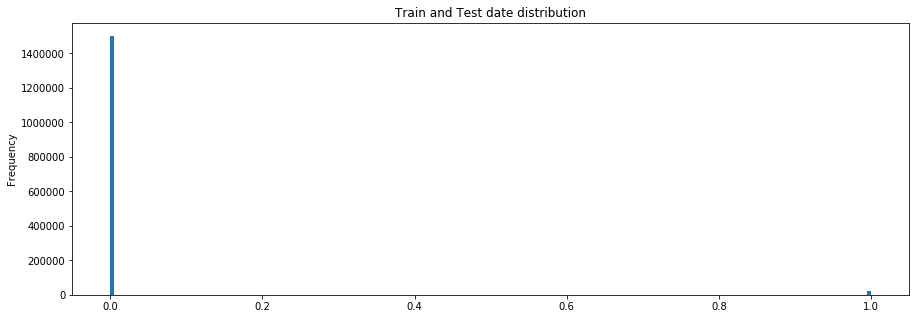

In [20]:
COL = 'fraud_ind'
df[COL].plot(kind='hist', figsize=(15, 5), label='test', bins=200, title='Train and Test date distribution')
df_test[COL].plot(kind='hist', label='train', bins=200)
plt.legend()
plt.show()

In [22]:
change_time(df)
change_time(df_test)
df.columns

loctm_hour loctm_hour_min loctm_min loctm_s
loctm_hour loctm_hour_min loctm_min loctm_s


Index(['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'flbmk', 'flg_3dsmk', 'fraud_ind', 'hcefg', 'insfg', 'iterm', 'locdt',
       'loctm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'txkey',
       'loctm_hour', 'loctm_hour_min', 'loctm_min', 'loctm_s'],
      dtype='object')

In [24]:
#新特徵

encode_CB('conam','ovrlt',df,df_test)
encode_CB('bacno','cano',df,df_test) 
encode_CB('insfg','iterm',df,df_test) 
encode_CB('mcc','mchno',df,df_test)
encode_CB('stocn','scity',df,df_test)
encode_CB('stscd','csmcu',df,df_test)
encode_CB('cano','loctm_hour',df,df_test)
encode_CB('contp','mchno',df,df_test)
encode_CB('cano','mcc_mchno',df,df_test)
encode_CB('cano','locdt',df,df_test)
encode_CB('scity','mcc_mchno',df,df_test)
encode_CB('scity','mcc_mchno',df,df_test)

encode_CB('stocn_scity','mcc_mchno',df,df_test)

encode_CB('acqic','scity_mcc_mchno',df,df_test)
encode_CB('acqic','stocn_scity_mcc_mchno',df,df_test)
encode_CB('acqic','stocn_scity_mcc_mchno',df,df_test)

conam_ovrlt , bacno_cano , insfg_iterm , mcc_mchno , stocn_scity , stscd_csmcu , cano_loctm_hour , contp_mchno , cano_mcc_mchno , cano_locdt , scity_mcc_mchno , scity_mcc_mchno , stocn_scity_mcc_mchno , acqic_scity_mcc_mchno , acqic_stocn_scity_mcc_mchno , acqic_stocn_scity_mcc_mchno , 

In [164]:
count_features =['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'hcefg', 'iterm',   'mcc', 'mchno',
       'scity', 'stocn', 'stscd',  'loctm_hour', 'stocn_scity','mcc_mchno']   

encode_FE(df,df_test,count_features)
cf =  ['acqic_FE', 'bacno_FE','cano_FE','conam_FE', 'contp_FE', 'csmcu_FE','ecfg_FE','etymd_FE' ,
       'hcefg_FE','iterm_FE','mcc_FE','mchno_FE','scity_FE','stocn_FE'
       ,'stscd_FE','loctm_hour_FE','stocn_scity_FE','mcc_mchno_FE']

acqic_FE , bacno_FE , cano_FE , conam_FE , contp_FE , csmcu_FE , ecfg_FE , etymd_FE , hcefg_FE , iterm_FE , mcc_FE , mchno_FE , scity_FE , stocn_FE , stscd_FE , loctm_hour_FE , stocn_scity_FE , mcc_mchno_FE , 

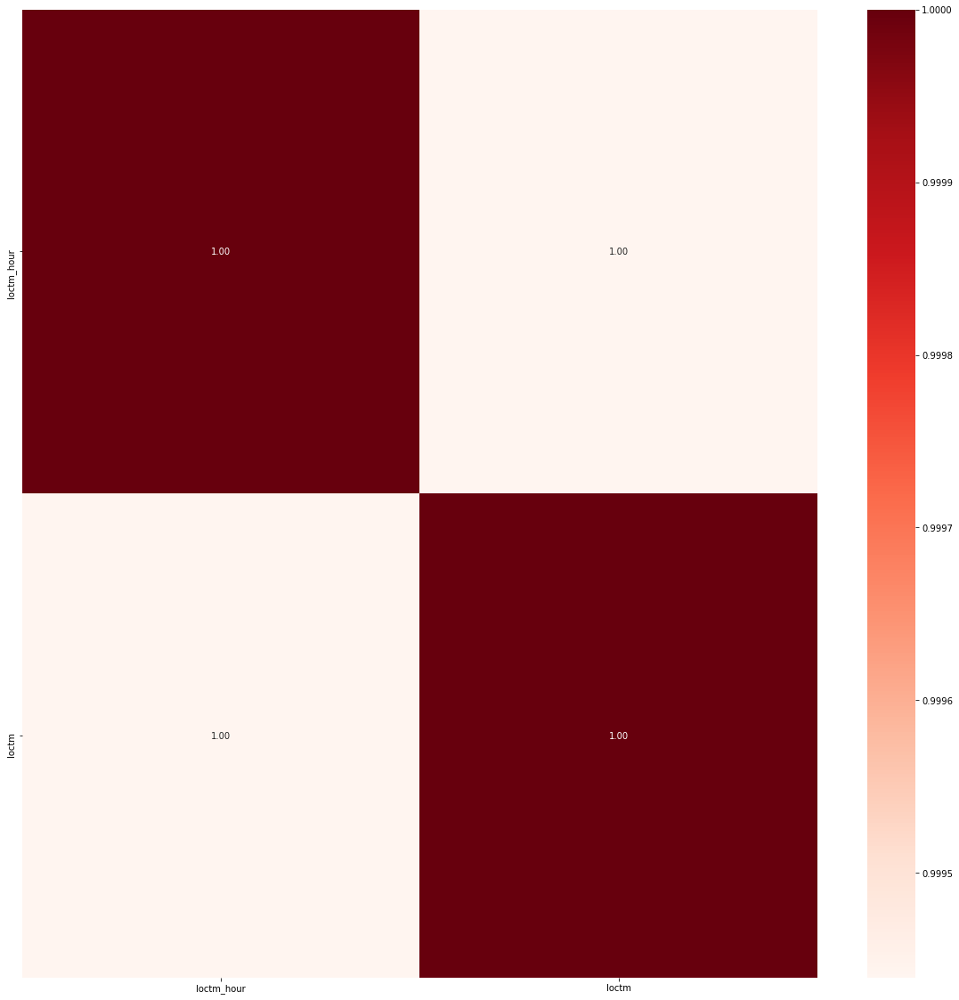

In [32]:
show_cor(df[['loctm_hour', 'loctm']])

In [ ]:
col1s = ['acqic', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'hcefg', 'iterm',   'mcc', 'mchno',
       'scity', 'stocn', 'stscd',  'loctm_hour', 'stocn_scity','mcc_mchno']   

In [176]:
col1s = ['acqic', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'hcefg', 'iterm',   'mcc', 'mchno',
       'scity', 'stocn', 'stscd',  'loctm_hour', 'stocn_scity','mcc_mchno']   
for col in col1s:      
    group_ag([col],['cano_locdt'],df,df_test,['mean','std'])
    
#show_cor(df)

'acqic__cano_locdt_mean' , 'acqic__cano_locdt_std' , 'conam__cano_locdt_mean' , 'conam__cano_locdt_std' , 'contp__cano_locdt_mean' , 'contp__cano_locdt_std' , 'csmcu__cano_locdt_mean' , 'csmcu__cano_locdt_std' , 'ecfg__cano_locdt_mean' , 'ecfg__cano_locdt_std' , 'etymd__cano_locdt_mean' , 'etymd__cano_locdt_std' , 'hcefg__cano_locdt_mean' , 'hcefg__cano_locdt_std' , 'iterm__cano_locdt_mean' , 'iterm__cano_locdt_std' , 'mcc__cano_locdt_mean' , 'mcc__cano_locdt_std' , 'mchno__cano_locdt_mean' , 'mchno__cano_locdt_std' , 'scity__cano_locdt_mean' , 'scity__cano_locdt_std' , 'stocn__cano_locdt_mean' , 'stocn__cano_locdt_std' , 'stscd__cano_locdt_mean' , 'stscd__cano_locdt_std' , 'loctm_hour__cano_locdt_mean' , 'loctm_hour__cano_locdt_std' , 'stocn_scity__cano_locdt_mean' , 'stocn_scity__cano_locdt_std' , 'mcc_mchno__cano_locdt_mean' , 'mcc_mchno__cano_locdt_std' , 

In [85]:
encode_CB('locdt','loctm_hour',df,df_test)
encode_CB('locdt','mcc',df,df_test)
encode_CB('cano','locdt_mcc',df,df_test)

locdt_loctm_hour , locdt_mcc , cano_locdt_mcc , 

In [120]:
for col in cano_col:
    encode_CB('bacno',col,df,df_test)

'bacno_acqic' , 'bacno_conam' , 'bacno_csmcu' , 'bacno_ecfg' , 'bacno_etymd' , 'bacno_locdt' , 'bacno_loctm' , 'bacno_mcc' , 'bacno_mchno' , 'bacno_scity' , 'bacno_stocn' , 'bacno_stscd' , 'bacno_loctm_hour' , 'bacno_loctm_min' , 'bacno_loctm_s' , 

In [108]:
cano_col=['acqic', 'conam', 'csmcu', 'ecfg', 'etymd',
        'locdt', 'loctm', 'mcc', 'mchno', 'scity', 'stocn',
       'stscd',  'loctm_hour', 'loctm_min', 'loctm_s']
#新特徵
encode_CB('bacno','cano',df,df_test) 
encode_CB('mcc','mchno',df,df_test)
encode_CB('stocn','scity',df,df_test)
encode_CB('stscd','csmcu',df,df_test)
encode_CB('cano','mcc_mchno',df,df_test)



bacno_cano , mcc_mchno , stocn_scity , stscd_csmcu , cano_mcc_mchno , cano_acqic , cano_conam , cano_csmcu , cano_ecfg , cano_etymd , cano_locdt , cano_loctm , cano_mcc , cano_mchno , cano_scity , cano_stocn , cano_stscd , cano_loctm_hour , cano_loctm_min , cano_loctm_s , 

In [125]:
encode_CB('cano','mcc_mchno',df,df_test)
encode_CB('cano','stocn_scity',df,df_test)

'cano_mcc_mchno' , 'cano_stocn_scity' , 

In [121]:
for col in cano_col:
    encode_CB('cano',col,df,df_test)

'cano_acqic' , 'cano_conam' , 'cano_csmcu' , 'cano_ecfg' , 'cano_etymd' , 'cano_locdt' , 'cano_loctm' , 'cano_mcc' , 'cano_mchno' , 'cano_scity' , 'cano_stocn' , 'cano_stscd' , 'cano_loctm_hour' , 'cano_loctm_min' , 'cano_loctm_s' , 

In [124]:
cols =['bacno_acqic' , 'bacno_conam' , 'bacno_csmcu' , 'bacno_ecfg' , 'bacno_etymd' , 'bacno_locdt' , 'bacno_loctm' , 'bacno_mcc' , 'bacno_mchno' , 'bacno_scity' , 'bacno_stocn' , 'bacno_stscd' , 'bacno_loctm_hour' , 'bacno_loctm_min' , 'bacno_loctm_s']
for col in cols:
    print(col,' :',df[col].nunique())


bacno_acqic  : 434881
bacno_conam  : 1170014
bacno_csmcu  : 150849
bacno_ecfg  : 139806
bacno_etymd  : 248544
bacno_locdt  : 1089316
bacno_loctm  : 1502879
bacno_mcc  : 511096
bacno_mchno  : 760524
bacno_scity  : 325507
bacno_stocn  : 143612
bacno_stscd  : 100085
bacno_loctm_hour  : 649311
bacno_loctm_min  : 1121229
bacno_loctm_s  : 1150636


In [126]:
cols =['cano_acqic' , 'cano_conam' , 'cano_csmcu' , 'cano_ecfg' , 'cano_etymd' , 'cano_locdt' , 'cano_loctm' , 'cano_mcc' , 'cano_mchno' , 'cano_scity' , 'cano_stocn' , 'cano_stscd' , 'cano_loctm_hour' , 'cano_loctm_min' , 'cano_loctm_s' ,'cano_mcc_mchno' , 'cano_stocn_scity'  ]
for col in cols:
    print(col,' :',df[col].nunique())


cano_acqic  : 472190
cano_conam  : 1185950
cano_csmcu  : 188112
cano_ecfg  : 180639
cano_etymd  : 293353
cano_locdt  : 1126285
cano_loctm  : 1503117
cano_mcc  : 549201
cano_mchno  : 784076
cano_scity  : 368782
cano_stocn  : 179201
cano_stscd  : 134063
cano_loctm_hour  : 728272
cano_loctm_min  : 1188657
cano_loctm_s  : 1222066
cano_mcc_mchno  : 786034
cano_stocn_scity  : 373201


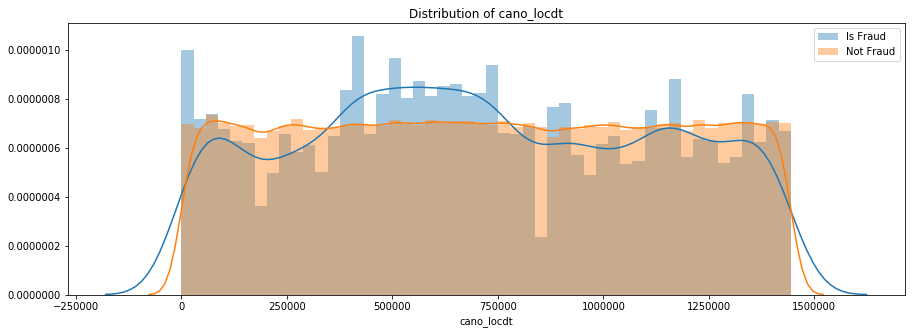

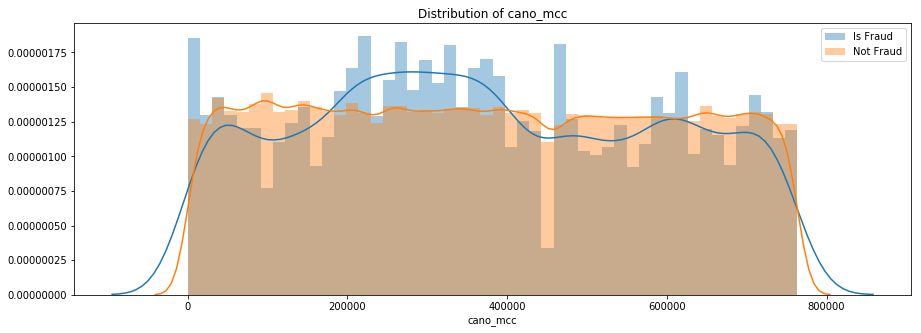

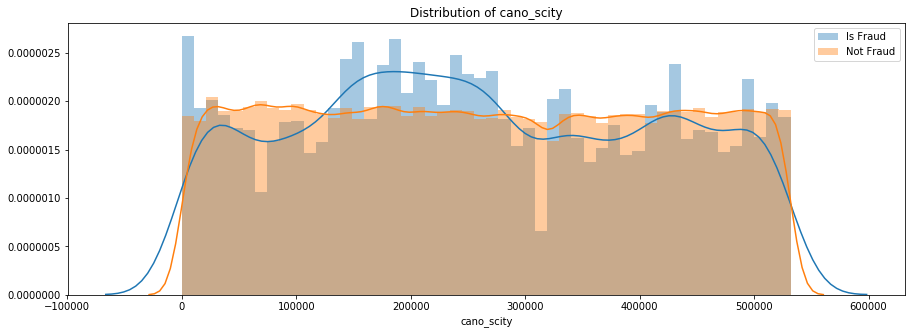

In [110]:
cols =['cano_locdt','cano_mcc','cano_scity']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=50);
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=50); 
    plt.legend();
    plt.title('Distribution of '+col);

In [92]:
encode_CB('bacno','mcc',df,df_test)
encode_CB('cano','mcc',df,df_test)

bacno_mcc , cano_mcc , 

In [174]:
df[df['fraud_ind']==0]['stscd'].value_counts().sort_index()

0    1488066
1        383
2      12855
3        108
4         20
Name: stscd, dtype: int64

In [175]:
df[df['fraud_ind']==1]['stscd'].value_counts().sort_index()

0    14679
1       25
2     5651
Name: stscd, dtype: int64

In [158]:
gf =['acqic__conam_ovrlt_mean' , 'acqic__conam_ovrlt_std' , 'conam__conam_ovrlt_mean' , 'conam__conam_ovrlt_std' , 'contp__conam_ovrlt_mean' , 'contp__conam_ovrlt_std' , 'csmcu__conam_ovrlt_mean' , 'csmcu__conam_ovrlt_std' , 'ecfg__conam_ovrlt_mean' , 'ecfg__conam_ovrlt_std' , 'etymd__conam_ovrlt_mean' , 'etymd__conam_ovrlt_std' , 'hcefg__conam_ovrlt_mean' , 'hcefg__conam_ovrlt_std' , 'iterm__conam_ovrlt_mean' , 'iterm__conam_ovrlt_std' , 'mcc__conam_ovrlt_mean' , 'mcc__conam_ovrlt_std' , 'mchno__conam_ovrlt_mean' , 'mchno__conam_ovrlt_std' , 'scity__conam_ovrlt_mean' , 'scity__conam_ovrlt_std' , 'stocn__conam_ovrlt_mean' , 'stocn__conam_ovrlt_std' , 'stscd__conam_ovrlt_mean' , 'stscd__conam_ovrlt_std' , 'loctm_hour__conam_ovrlt_mean' , 'loctm_hour__conam_ovrlt_std' , 'stocn_scity__conam_ovrlt_mean' , 'stocn_scity__conam_ovrlt_std' , 'mcc_mchno__conam_ovrlt_mean' , 'mcc_mchno__conam_ovrlt_std' , ]

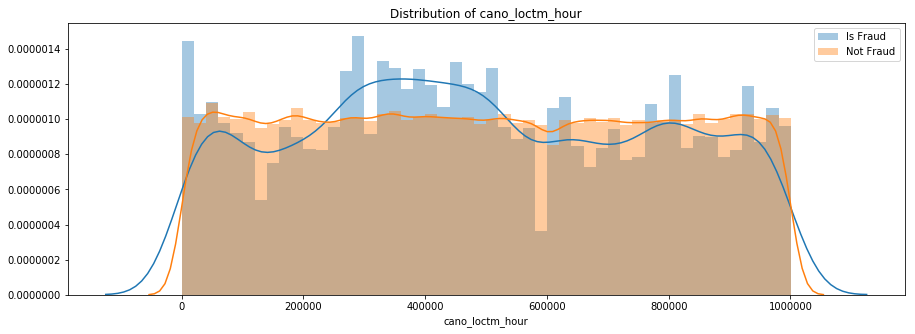

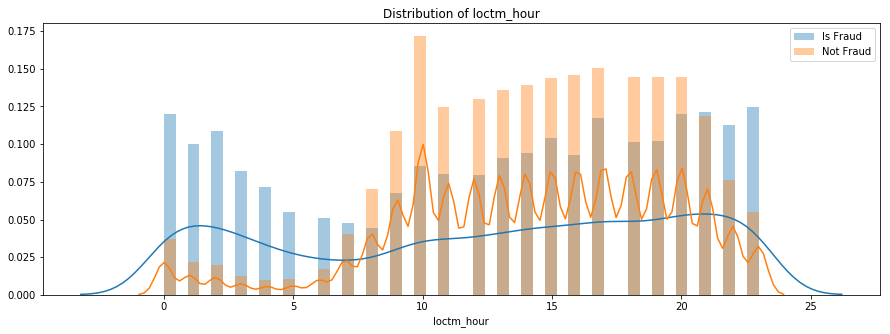

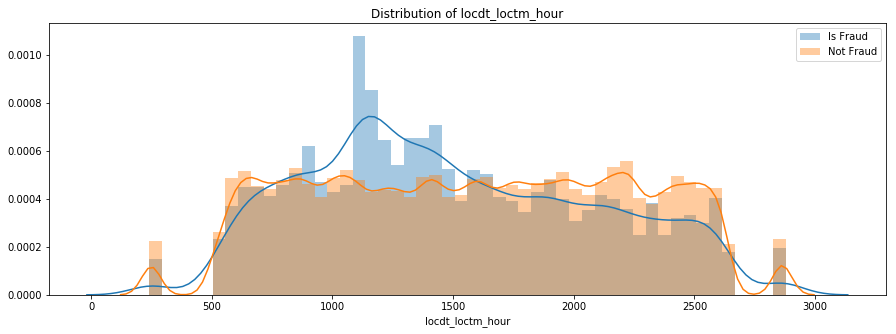

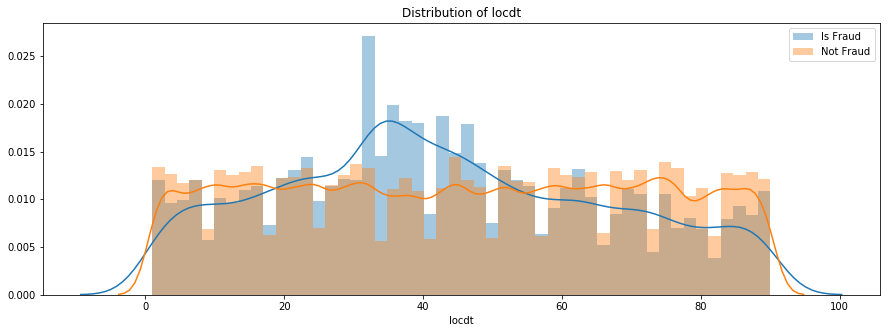

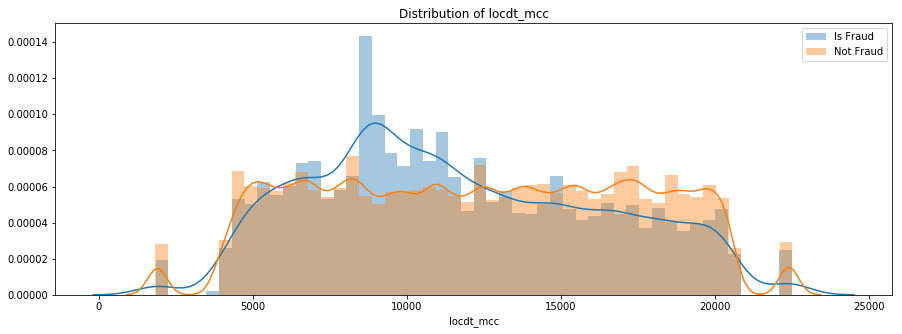

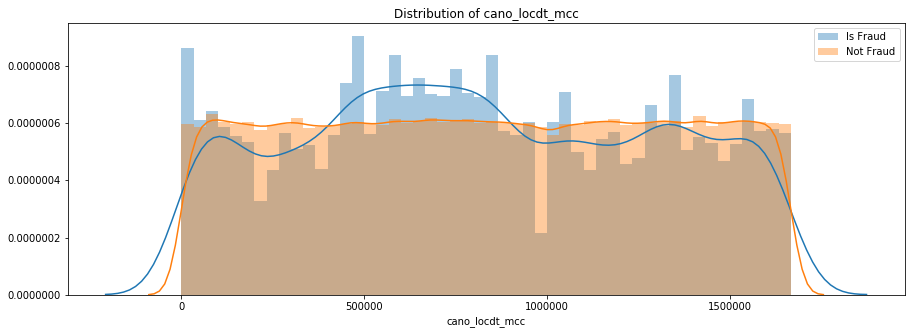

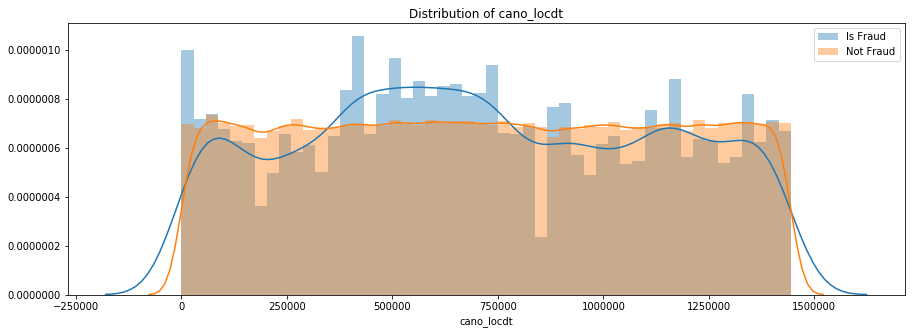

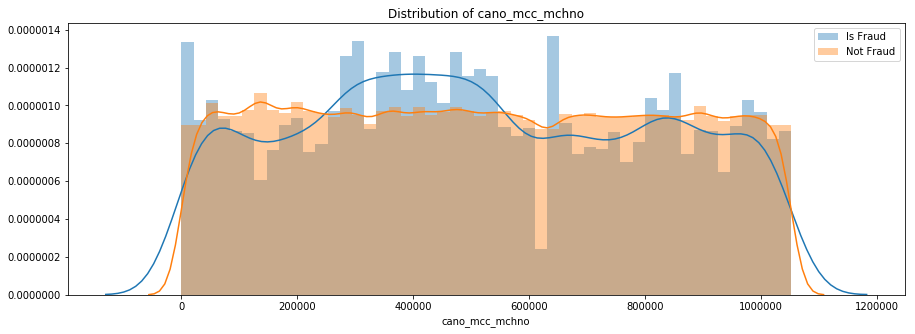

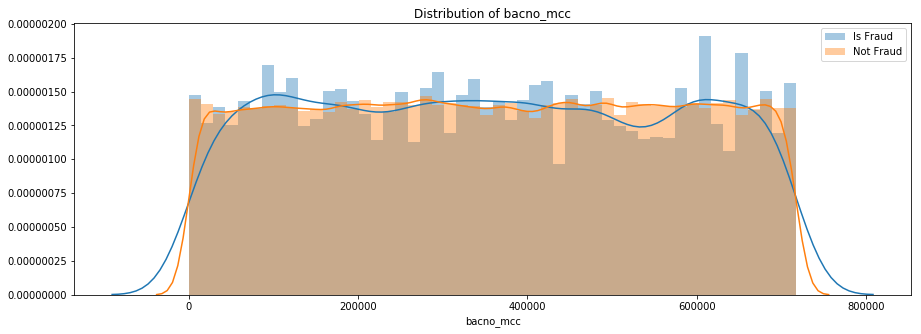

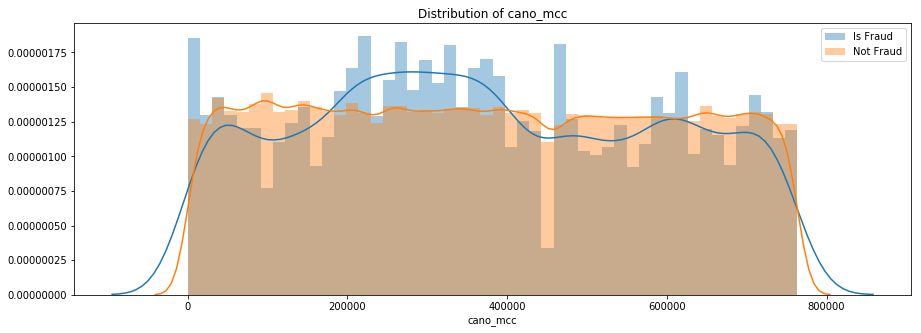

In [93]:
#conam_ovrlt
cols =['cano_loctm_hour','loctm_hour','locdt_loctm_hour','locdt','locdt_mcc','cano_locdt_mcc','cano_locdt','cano_mcc_mchno','bacno_mcc','cano_mcc']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=50);
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=50); 
    plt.legend();
    plt.title('Distribution of '+col);

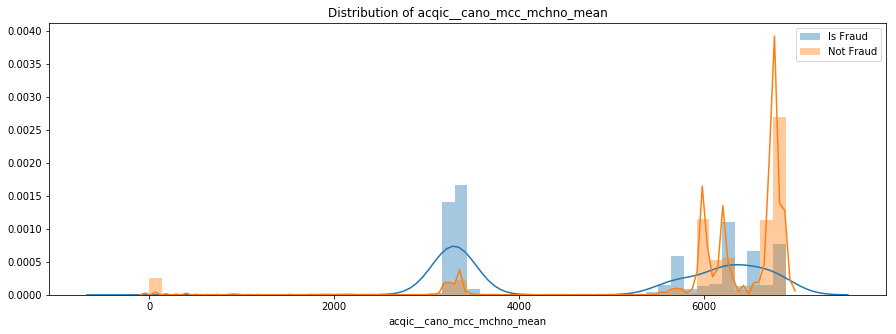

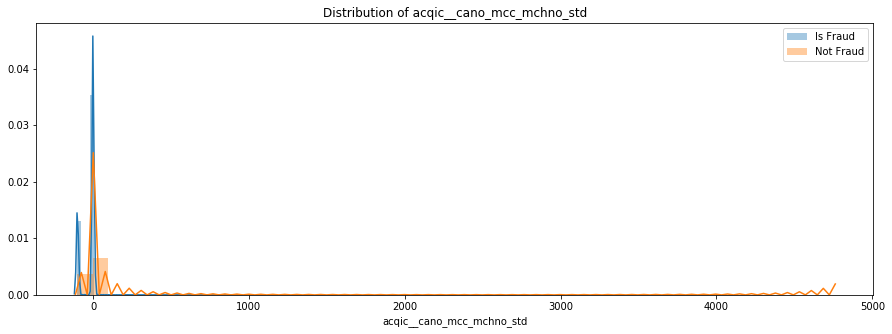

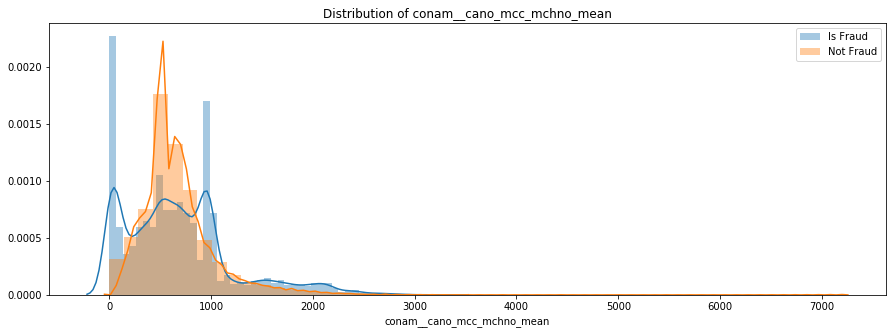

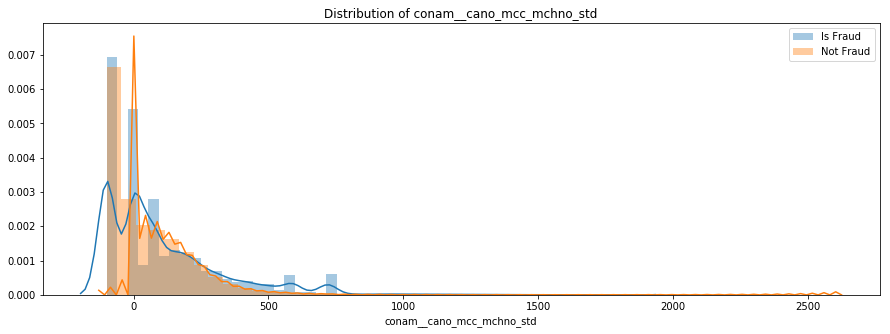

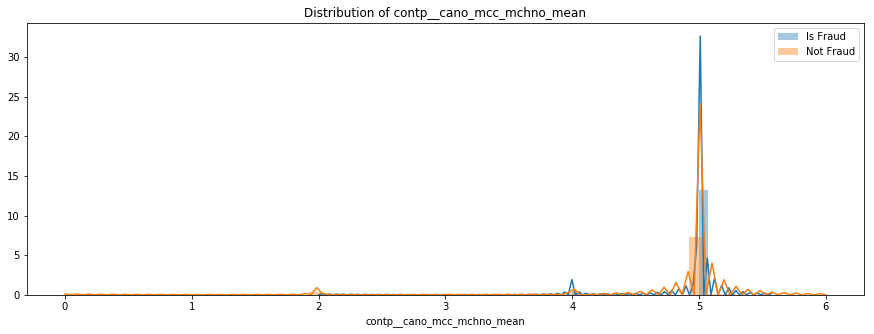

...

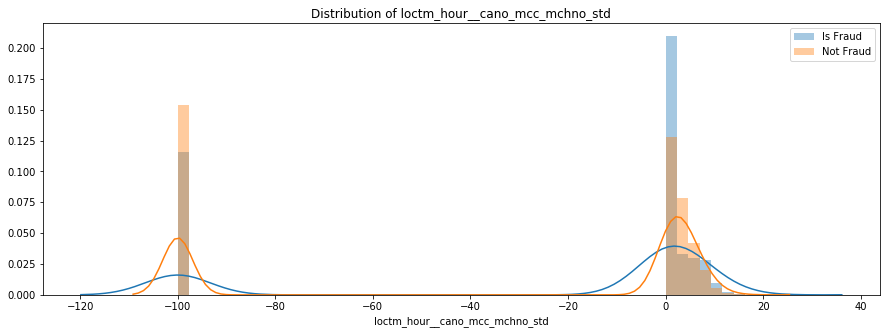

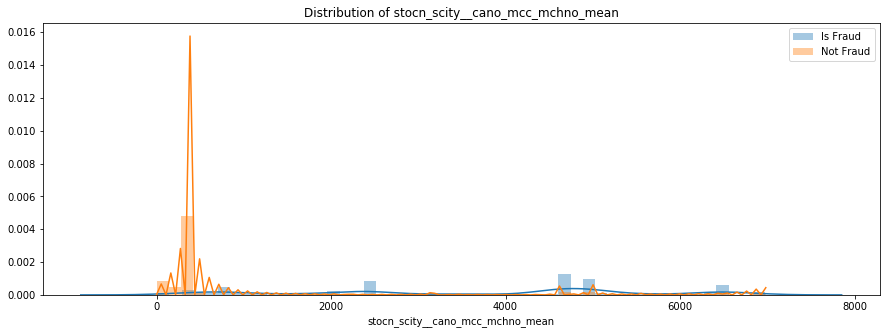

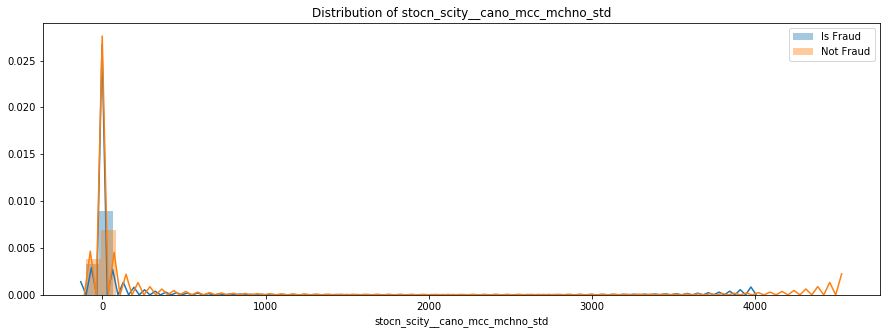

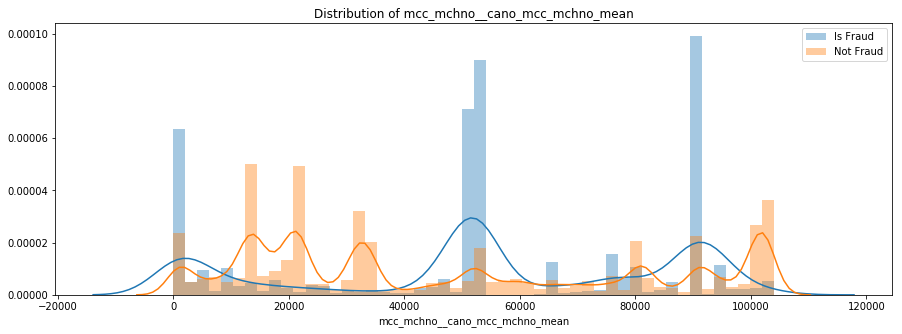

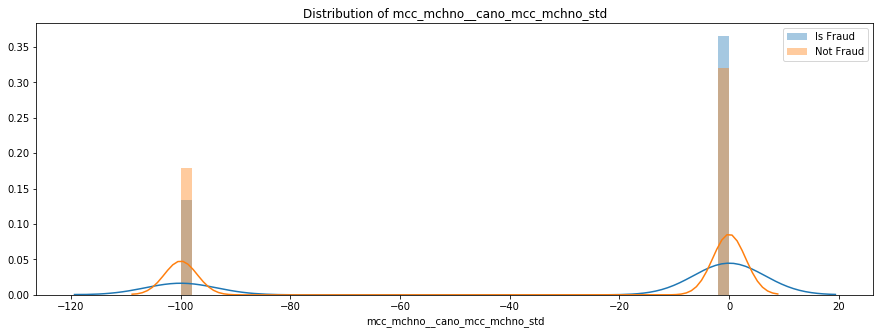

In [141]:
#cano_mcc_mchno
cols =gf
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=50);
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=50); 
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
df[df['fraud_ind']==1]['iterm'].value_counts()

In [ ]:
df[df['fraud_ind']==0]['iterm'].value_counts()

In [ ]:
for col in df.columns:
    print('yes')
    print(df[df['fraud_ind']==1][col].value_counts())
    print('no')
    print(df[df['fraud_ind']==0][col].value_counts())
    print("-------------------------------------------------")

In [ ]:
print('yes')
print(df[df['fraud_ind']==1]['etymd'].value_counts())
print('no')
print(df[df['fraud_ind']==0]['etymd'].value_counts())

In [248]:
df['stocn_scity'].nunique()

5975

In [249]:
df['stocn'].nunique()

103

In [250]:
df['scity'].nunique()

5698

In [251]:
df['bacno_cano'].nunique()

129413

In [252]:
df['bacno'].nunique()

95214

In [253]:
df['cano'].nunique()

129413

In [134]:
for i in range(1,10):
    print(df[(df.fraud_ind == 1) & (df.locdt == i)]['txkey'].sum())

203081268
239133023
211553115
181634394
198402751
227495626
247431221
233086472
231570511


In [132]:
df[(df.fraud_ind == 1) & (df.locdt ==2 )]['txkey'].sum()

239133023

In [105]:
df1 = 
df1.sort_values(by=['locdt','fraud_ind','loctm'], ascending=True)

,acqic,bacno,cano,conam,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,fraud_ind,hcefg,insfg,iterm,locdt,loctm,mcc,mchno,ovrlt,scity,stocn,stscd,txkey,loctm_hour,loctm_hour_min,loctm_min,loctm_s,conam_ovrlt,bacno_cano,insfg_iterm,mcc_mchno,stocn_scity,stscd_csmcu,cano_loctm_hour,contp_mchno,cano_mcc_mchno,cano_locdt,scity_mcc_mchno,stocn_scity_mcc_mchno,acqic_scity_mcc_mchno,acqic_stocn_scity_mcc_mchno,locdt_loctm_hour,locdt_mcc,locdt_mcc_cano,cano_locdt_mcc,bacno_mcc,cano_mcc
994820,6215,38871,154469,407.87,5,62,1,2,0.0,0.0,1,5,0,0,1,1704.0,289,54828,0,3460,46,0,1832994,0,17,17,4,60827,124209,0,51992,4995,57,288818,55198,300544,421445,19372,90889,66563,66659,743,5831,1315660,486371,419804,216166
610000,6215,38871,154469,407.87,5,62,1,2,0.0,0.0,1,5,0,0,1,2024.0,289,54828,0,3460,46,0,1832999,0,20,20,24,60827,124209,0,51992,4995,57,288818,55198,300544,421445,19372,90889,66563,66659,743,5831,1315660,486371,419804,216166
546704,3348,101591,17348,407.87,5,62,1,8,0.0,0.0,1,5,0,0,1,4015.0,289,54828,0,3460,46,0,641504,0,40,40,15,60827,2309,0,51992,4995,57,393346,55198,411563,573499,19372,90889,11784,11839,743,5831,1315701,662615,7644,296349
807445,3348,48691,153351,118.51,5,62,1,8,0.0,0.0,1,5,0,0,1,10308.0,289,54828,0,3460,46,2,641533,1,103,3,8,8132,138418,0,51992,4995,116,282812,55198,294353,412825,19372,90889,11784,11839,744,5831,1315656,476410,467294,211647
895769,3348,9427,200893,794.93,5,62,1,8,0.0,0.0,1,5,0,0,1,10652.0,289,54828,0,3460,46,0,641541,1,106,6,52,81533,204107,0,51992,4995,57,540315,55198,564108,783799,19372,90889,11784,11839,744,5831,1315785,906102,690016,406954
1517783,3348,9427,200893,794.93,5,62,1,8,0.0,0.0,1,5,0,0,1,10847.0,289,54828,0,3460,46,0,641544,1,108,8,47,81533,204107,0,51992,4995,57,540315,55198,564108,783799,19372,90889,11784,11839,744,5831,1315785,906102,690016,406954
1416749,3207,36103,100698,426.47,5,62,1,8,0.0,0.0,1,5,0,0,1,12145.0,218,12011,0,5324,104,0,641490,1,121,21,45,61836,120252,0,9588,2057,57,4083,8989,4679,5820,41960,9358,8153,8246,744,5785,1307190,6895,406301,3328
392531,3207,36103,100698,578.02,5,62,1,8,0.0,0.0,1,5,0,0,1,12953.0,218,12011,0,5324,104,0,641497,1,129,29,53,69775,120252,0,9588,2057,57,4083,8989,4679,5820,41960,9358,8153,8246,744,5785,1307190,6895,406301,3328
733037,3207,36103,100698,578.02,5,62,1,8,0.0,0.0,1,5,0,0,1,14634.0,218,12011,0,5324,104,0,641587,1,146,46,34,69775,120252,0,9588,2057,57,4083,8989,4679,5820,41960,9358,8153,8246,744,5785,1307190,6895,406301,3328
601872,3207,36103,100698,680.57,5,62,1,8,0.0,0.0,1,5,0,0,1,15302.0,218,12011,0,5324,104,0,641594,1,153,53,2,75450,120252,0,9588,2057,57,4083,8989,4679,5820,41960,9358,8153,8246,744,5785,1307190,6895,406301,3328


In [176]:
df[df['fraud_ind']==1]['scity'].value_counts()

6580    5657
3460    2682
6593    1545
1337    1103
0        801
5817     697
5320     518
621      480
5932     334
1803     260
6576     238
1034     187
4528     141
1060     139
955      139
3150     105
668      101
376      101
3441      90
5324      88
327       80
5776      78
1574      78
1300      75
5820      73
4099      72
2138      72
3199      67
6049      64
595       64
1910      61
3323      56
3426      55
3952      55
4356      54
1458      50
6577      48
1564      45
6189      44
6368      43
6221      42
2412      41
379       39
2362      39
1768      36
1457      34
2230      32
2030      32
4596      32
654       31
943       31
4822      30
3197      30
386       30
46        27
6364      27
5660      27
1894      27
1481      25
4582      25
5803      25
4091      25
4508      24
2317      23
5491      22
1486      21
4526      21
4226      21
1452      21
1613      21
1468      21
4609      21
6031      20
455       20
4740      20
405       20
5966      19

In [145]:
df[df['fraud_ind']==1]['mcc'].value_counts()

289    3789
380    3403
288    2631
192    2623
203     490
337     414
286     410
296     382
408     375
277     366
257     350
349     308
318     274
367     274
329     270
250     267
373     241
218     187
247     181
457     174
360     168
320     166
251     155
263     103
210      90
246      90
321      87
270      83
295      80
207      77
275      76
212      67
248      64
322      64
269      63
308      62
201      60
400      53
209      53
413      48
432      47
319      46
309      43
273      41
292      40
441      38
417      37
305      36
280      33
298      31
294      31
446      26
374      26
426      25
366      25
213      23
430      23
306      21
299      20
15       19
300      19
226      18
345      16
340      15
311      15
362      15
191      15
297      15
339      14
10       14
365      13
437      13
405      13
316      12
376      12
368      12
317      11
284      11
271      10
5        10
272       9
24        9
444       9
381 

In [173]:
print(df[df['fraud_ind']==1]['conam'].value_counts())
df[df['conam']==0]['txkey'].count()
#df[df['fraud_ind']==0]['conam'].max()

0.00       2573
1016.34    1985
103.48      405
513.80      212
288.05      208
407.87      201
814.14      135
794.93      121
1.38        117
236.43      112
696.35      112
677.88      107
102.61      104
155.07      103
216.12       91
0.08         88
1174.97      85
168.20       84
578.02       75
683.25       75
551.51       65
605.25       57
1050.50      56
682.99       56
652.61       56
417.33       55
101.74       50
102.40       47
1017.48      47
426.47       45
118.51       45
490.68       43
555.43       42
944.61       41
796.90       41
605.08       41
932.13       41
229.88       41
734.15       40
102.37       38
0.07         37
941.38       36
366.38       36
622.19       36
149.14       36
945.48       34
954.83       32
100.83       32
713.91       32
420.41       32
443.90       32
2139.30      30
102.32       30
543.51       30
524.74       29
102.45       29
943.22       29
938.22       29
938.18       28
317.01       28
342.90       28
1202.35      28
766.30  

46373

In [169]:
df['txkey'].count()

1521787

In [159]:
df['conam'].describe()

count    1.521787e+06
mean     6.547219e+02
std      4.028078e+02
min      0.000000e+00
25%      4.370600e+02
50%      5.919000e+02
75%      8.073400e+02
max      7.208770e+03
Name: conam, dtype: float64

In [25]:
for col in df[['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'flbmk', 'flg_3dsmk', 'fraud_ind', 'hcefg', 'insfg', 'iterm', 'locdt',
       'loctm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'txkey',
       'loctm_hour', 'loctm_hour_min', 'loctm_min', 'loctm_s','stocn_scity']]:
    if(df[col].nunique()<3):
        print(col)

ecfg
fraud_ind
insfg
ovrlt


In [46]:
df.columns

Index(['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'flbmk', 'flg_3dsmk', 'fraud_ind', 'hcefg', 'insfg', 'iterm', 'locdt',
       'loctm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'txkey',
       'loctm_hour', 'loctm_hour_min', 'loctm_min', 'loctm_s'],
      dtype='object')

In [178]:
col='mcc_mchno__cano_locdt_mean'# , 'mcc_mchno__cano_locdt_std']
df_IsTarget=df[['acqic', 'bacno','loctm_hour_min', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'hcefg', 'insfg', 'iterm', 'locdt',
       'loctm', 'mcc', 'mchno', 'scity', 'stocn', 'stscd',col]][df["fraud_ind"] == 1]

In [186]:
for index in df_IsTarget['cano'].sort_index().unique():
print(df[df['cano']==index]['conam'].value_counts())

85.64      1
475.89     1
1119.20    1
0.00       1
Name: conam, dtype: int64


In [204]:
df_IsTarget['bacno'].sort_index().nunique()

8643

In [205]:
df_IsTarget['cano'].sort_index().nunique()

8730

In [177]:
#(df.bacno == 38871) & (df.acqic == 62)
#(df.mcc==289) &
df[ (df.scity==6580)][['bacno','cano','conam','fraud_ind','loctm','locdt','acqic','stocn', 'scity','mcc','mchno','stscd', 'contp', 'csmcu', 'ecfg', 'etymd','flbmk', 'flg_3dsmk',
       'hcefg', 'insfg', 'iterm', ]].sort_values(by=['fraud_ind','cano'], ascending=False)

,bacno,cano,conam,fraud_ind,loctm,locdt,acqic,stocn,scity,mcc,mchno,stscd,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,hcefg,insfg,iterm
1044680,129322,211867,1016.34,1,110734.0,52,3348,38,6580,380,54238,0,5,75,1,8,-100.0,-100.0,6,0,0
238619,41690,209902,1016.34,1,160254.0,5,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
625558,41690,209902,1016.34,1,151047.0,18,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
707571,41690,209902,407.87,1,210518.0,1,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
870200,41690,209902,1016.34,1,232346.0,17,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
985173,41690,209902,407.87,1,15538.0,17,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
1072230,41690,209902,794.93,1,155421.0,5,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
1095239,41690,209902,407.87,1,15847.0,18,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
1280344,41690,209902,407.87,1,548.0,5,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
1305434,41690,209902,407.87,1,15627.0,17,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0


In [63]:
df[df['fraud_ind']==1][['cano','conam','loctm','locdt','acqic','stocn', 'scity','mcc','mchno','stscd', 'contp', 'csmcu', 'ecfg', 'etymd','flbmk', 'flg_3dsmk',
       'hcefg', 'insfg', 'iterm', ]].sort_values(by=['conam','locdt','loctm'], ascending=True)

,cano,conam,loctm,locdt,acqic,stocn,scity,mcc,mchno,stscd,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,hcefg,insfg,iterm
1378477,23,0.00,62252.0,50,5876,6,376,192,68362,2,5,4,1,8,0.0,0.0,5,0,0
985464,270,0.00,21909.0,45,3348,38,6580,380,54238,0,5,62,1,8,0.0,0.0,5,0,0
724486,547,0.00,154611.0,53,6540,104,1337,289,45597,2,5,61,0,2,0.0,0.0,5,0,0
1170570,558,0.00,165031.0,11,3288,93,621,337,20984,0,5,62,1,8,0.0,0.0,5,0,0
181777,593,0.00,113205.0,50,6215,38,6580,380,54238,0,5,62,0,2,0.0,0.0,5,0,0
1067910,609,0.00,214935.0,69,3191,52,5932,318,69303,2,4,26,1,8,0.0,0.0,5,0,0
69795,676,0.00,162012.0,62,6215,38,6580,380,54238,0,5,62,0,2,0.0,0.0,5,0,0
302680,906,0.00,203529.0,43,6215,38,6580,380,54238,0,5,62,0,2,0.0,0.0,5,0,0
491832,906,0.00,104050.0,45,6215,38,6580,380,54238,0,5,62,0,2,0.0,0.0,5,0,0
273584,1014,0.00,110425.0,34,3357,75,3199,192,56035,0,5,62,1,8,0.0,0.0,5,0,0


In [106]:
#(df.bacno == 38871) & (df.acqic == 62)
df[df['bacno']==38871][['cano','conam','fraud_ind','acqic','stocn', 'scity','mcc','mchno','loctm','locdt','stscd', 'contp', 'csmcu', 'ecfg', 'etymd','flbmk', 'flg_3dsmk',
       'hcefg', 'insfg', 'iterm', ]].sort_values(by=['conam','locdt','fraud_ind','loctm'], ascending=True)

,cano,conam,fraud_ind,acqic,stocn,scity,mcc,mchno,loctm,locdt,stscd,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,hcefg,insfg,iterm
559341,154469,0.00,0,6215,46,3460,289,54828,1410.0,1,0,5,62,0,2,0.0,0.0,5,0,0
1227918,154470,0.00,0,6540,104,3235,246,41763,143649.0,86,0,5,61,0,2,0.0,0.0,5,0,0
523225,154470,168.20,0,6716,102,5820,247,34213,131019.0,65,0,5,62,1,2,0.0,0.0,5,0,0
553597,154470,171.79,0,6716,102,5820,247,34213,115428.0,82,0,5,62,1,2,0.0,0.0,5,0,0
93912,154470,178.77,0,6716,102,5820,247,34213,945.0,74,0,5,62,1,2,0.0,0.0,5,0,0
998363,154470,254.99,0,6716,102,5820,247,34213,43054.0,79,0,5,62,1,2,0.0,0.0,5,0,0
303111,154470,306.79,0,6716,102,5820,247,34213,173217.0,68,0,5,62,1,2,0.0,0.0,5,0,0
36234,154470,358.79,0,6716,102,5820,247,34213,124501.0,35,0,5,62,1,2,0.0,0.0,5,0,0
994820,154469,407.87,1,6215,46,3460,289,54828,1704.0,1,0,5,62,1,2,0.0,0.0,5,0,0
610000,154469,407.87,1,6215,46,3460,289,54828,2024.0,1,0,5,62,1,2,0.0,0.0,5,0,0


In [179]:
df_IsTarget.sort_values(by=[ 'cano','loctm','locdt'], ascending=True)

,acqic,bacno,loctm_hour_min,cano,conam,contp,csmcu,ecfg,etymd,hcefg,insfg,iterm,locdt,loctm,mcc,mchno,scity,stocn,stscd,mcc_mchno__cano_locdt_mean
1378477,5876,41871,622,23,0.00,5,4,1,8,5,0,0,50,62252.0,192,68362,376,6,2,1171.000000
521926,5876,41871,622,23,85.64,5,4,1,8,5,0,0,50,62253.0,192,68362,376,6,2,1171.000000
646271,5993,25286,1311,34,668.27,5,62,0,2,5,0,0,83,131110.0,311,9215,1803,75,0,74181.000000
297765,5720,160485,119,102,2077.32,5,20,1,8,5,0,0,69,11914.0,349,67619,1803,75,2,45374.000000
366488,5720,160485,119,102,2077.32,5,20,1,8,5,0,0,69,11914.0,203,67656,1803,75,2,45374.000000
214322,3348,43024,4,132,1202.35,5,62,1,8,5,0,0,58,409.0,380,54238,6580,38,0,91244.000000
426754,3348,43024,11,132,1018.62,5,62,1,8,5,0,0,58,1130.0,380,54238,6580,38,0,91244.000000
555320,3348,43024,2034,133,1016.34,5,62,1,8,5,0,0,61,203423.0,380,54238,6580,38,0,91244.000000
237650,3348,50276,46,149,794.93,5,62,1,8,5,0,0,63,4640.0,289,54828,3460,46,0,51992.000000
1099135,3207,79233,1856,151,1494.64,5,61,1,8,5,0,0,9,185642.0,277,11851,4687,104,0,43925.500000


In [29]:
pd.set_option('display.max_rows', 10000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
#df_IsTarget.sort_values(by=['locdt','bacno', 'cano','loctm'], ascending=True)
df[df['bacno']==36103][['cano','conam','ovrlt','fraud_ind','loctm','locdt','acqic','stocn', 'scity','mcc','mchno','stscd', 'contp', 'csmcu', 'ecfg', 'etymd','flbmk', 'flg_3dsmk',
       'hcefg', 'insfg', 'iterm', ]].sort_values(by=['locdt','fraud_ind','loctm'], ascending=True)

,cano,conam,ovrlt,fraud_ind,loctm,locdt,acqic,stocn,scity,mcc,mchno,stscd,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,hcefg,insfg,iterm
1416749,100698,426.47,0,1,12145.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
392531,100698,578.02,0,1,12953.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
733037,100698,578.02,0,1,14634.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
601872,100698,680.57,0,1,15302.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
808042,100698,578.02,0,1,115108.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
338920,100698,578.02,0,1,124555.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
1127418,100698,578.02,0,1,125426.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
1217941,100698,578.02,0,1,130131.0,1,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
746959,100698,578.02,0,1,104143.0,2,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0
1126393,100698,578.02,0,1,111755.0,2,3207,104,5324,218,12011,0,5,62,1,8,0.0,0.0,5,0,0


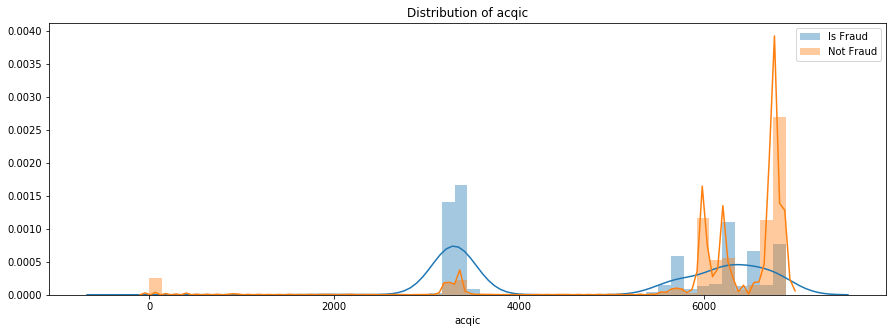

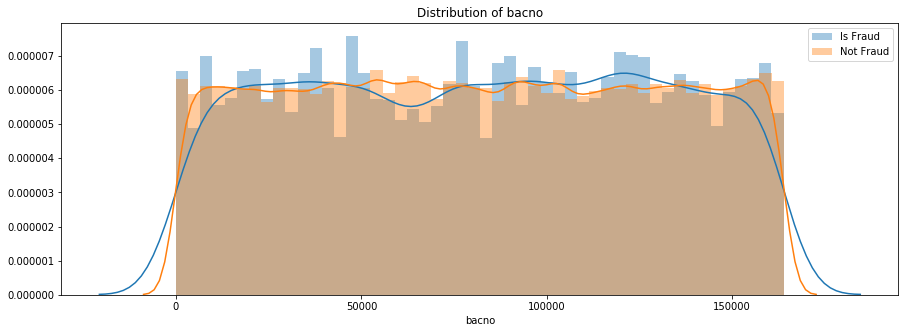

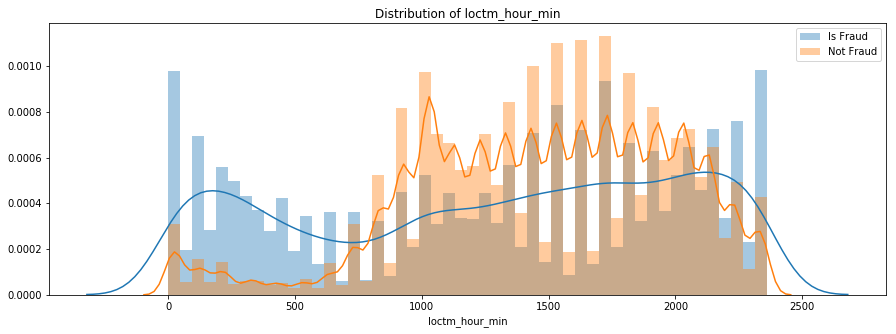

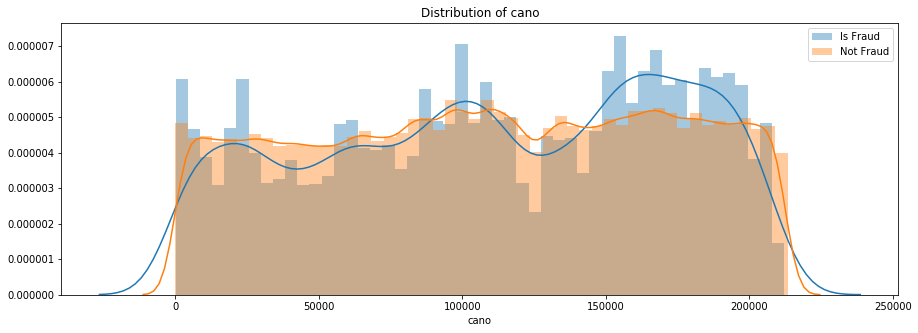

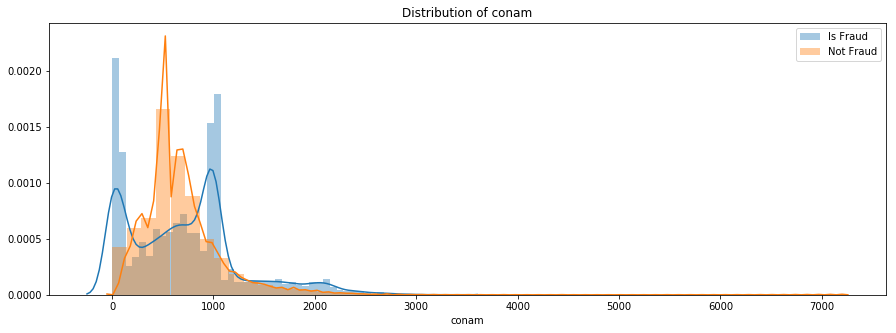

...

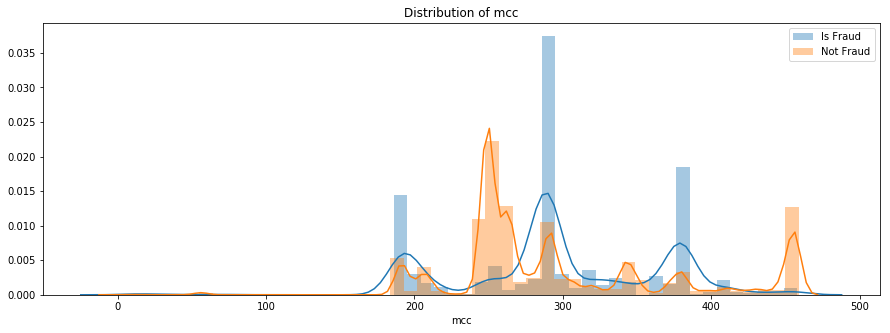

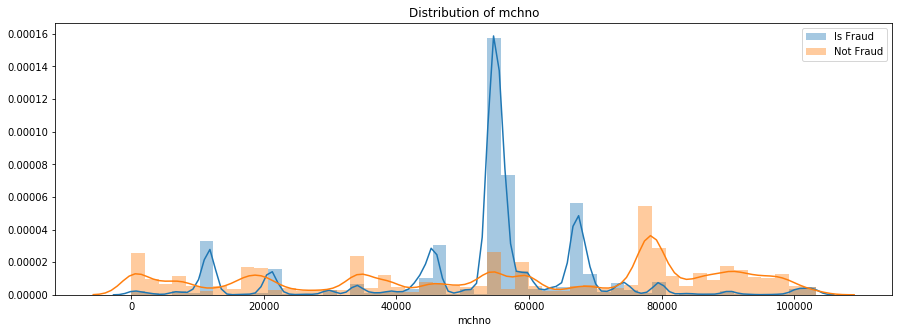

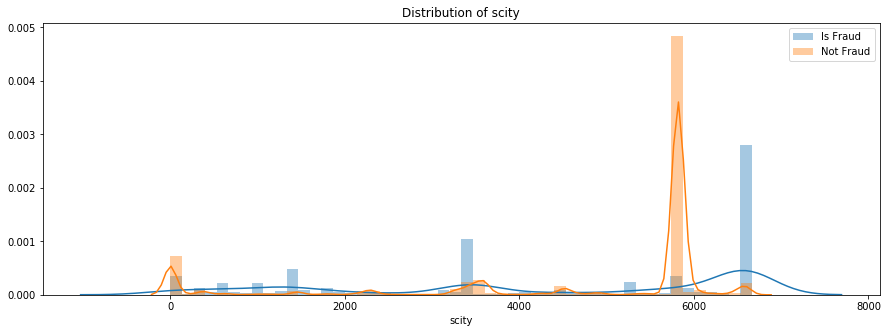

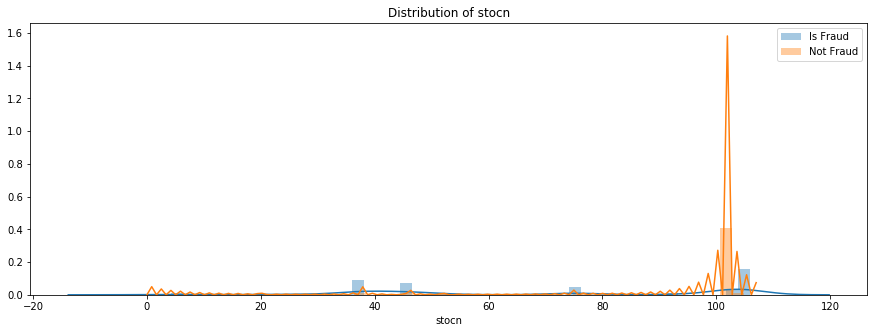

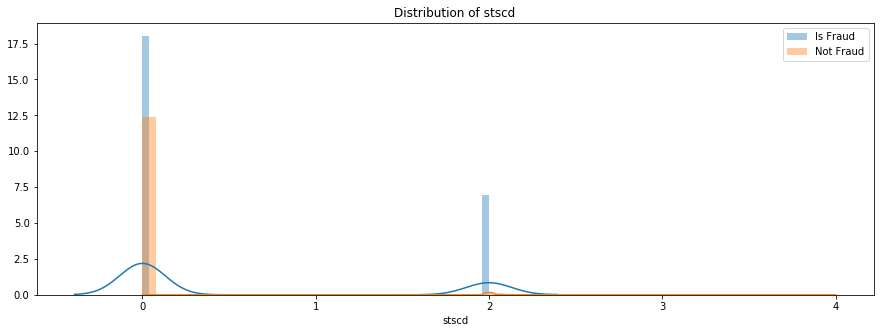

In [62]:
for i, col  in enumerate(df_IsTarget.columns):
    plt.figure(figsize=(15,5))
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=50);
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=50);    
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
cols =['locdt','loctm']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.kdeplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',color="b");  
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=100)
    plt.legend();
    plt.title('Distribution of '+col);

In [66]:
df.columns

Index(['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd', 'flbmk', 'flg_3dsmk', 'fraud_ind', 'hcefg', 'insfg', 'iterm', 'locdt', 'loctm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'txkey', 'loctm_hour', 'loctm_hour_min', 'loctm_min', 'loctm_s'], dtype='object')

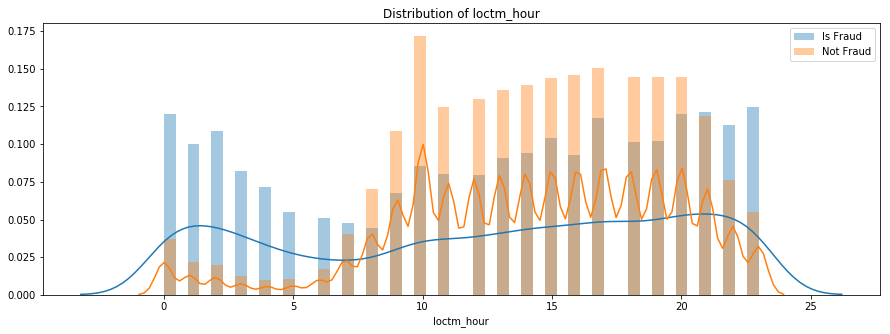

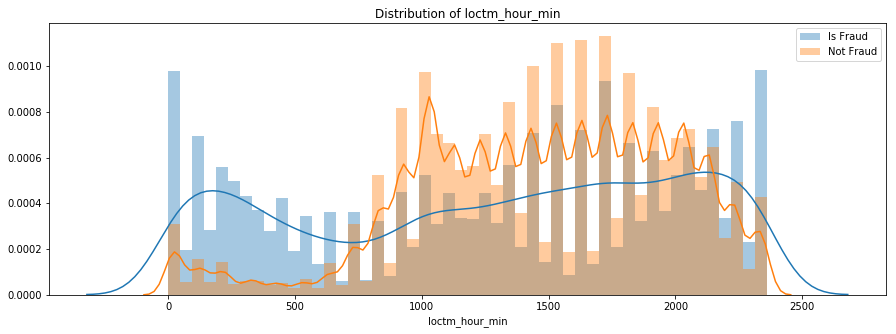

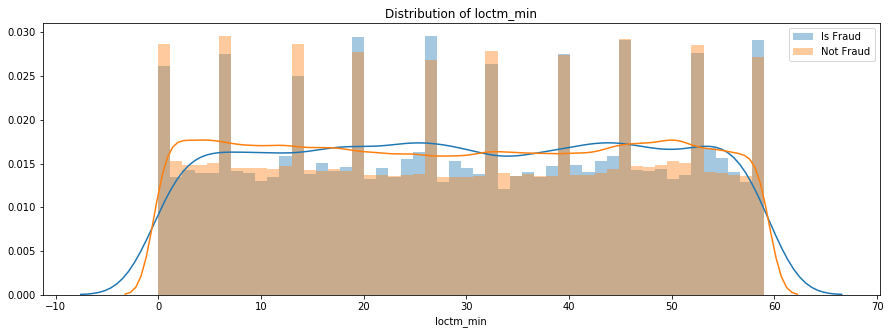

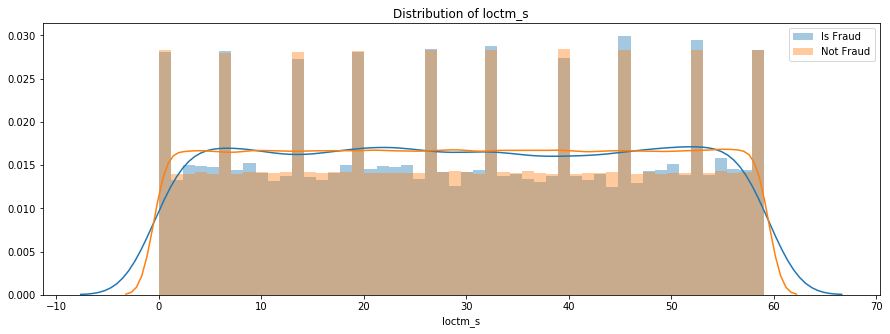

In [67]:
cols =['loctm_hour', 'loctm_hour_min', 'loctm_min', 'loctm_s']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=50);
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=50); 
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
df_IsTarget = df[['mcc','mchno']][df["fraud_ind"] == 1]

In [ ]:
df_IsTarget['scity'].value_counts()

In [ ]:
df_EDF = df[df.cano ==36103     ]
df_EDF['fraud_ind'].value_counts()

In [ ]:
#change_time(df)
#change_time(df_test)
df.columns
import copy
df_backup = copy.copy(df)
df_test_backup = copy.copy(df_test)

In [ ]:
COL = 'locdt'
df[COL].plot(kind='hist', figsize=(15, 5), label='test', bins=200, title='Train and Test date distribution')
df_test[COL].plot(kind='hist', label='train', bins=200)
plt.legend()
plt.show()

In [ ]:
df.columns


In [ ]:
col = 'acqic'
col2 = 'fraud_ind'
plt.figure(figsize=(30,14))
g = sns.distplot(df[df[col2] == 1][col], label='Fraud')
g = sns.distplot(df[df[col2] == 0][col], label='NoFraud')

g.legend()
g.set_title("Card 1 Values Distribution by Target", fontsize=20)
g.set_xlabel(col," Values", fontsize=18)
g.set_ylabel("Probability", fontsize=18)

In [ ]:
df.sort_values(by=['locdt'], ascending=False)
cols =['acqic']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.kdeplot(df['acqic']['locdt'],label = 'acqic by locdt',color="b");     
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
cols =['locdt','loctm']
for col in cols:    
    plt.figure(figsize=(15,5))
    sns.kdeplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',color="b");  
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=100)
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
df_new = df[df['fraud_ind']==0]
df_new_f =df[df['fraud_ind']==1]
for col in df_new[10:]:
    print(col)
    print('not fraud')
    print(df_new[col].value_counts())
    print('is fraud')
    print(df_new_f[col].value_counts())
    print("_"*20)

In [ ]:
for i, col  in enumerate(df[df_test.columns]):   
    plot_numerical(col,df,df_test)

## 訓練集詐騙比重


In [ ]:

from matplotlib import gridspec
plt.figure(figsize=(16,30*4))
gs = gridspec.GridSpec(df.shape[1], 1)
for i, col  in enumerate(df[df.columns]):    
    ax = plt.subplot(gs[i])
    sns.distplot(df[col][df["fraud_ind"] == 1],label = 'Is Fraud',bins=100)
    sns.distplot(df[col][df["fraud_ind"] == 0],label = 'Not Fraud',bins=100)
    plt.legend();
    ax.set_xlabel('histogram of feature: ' + str(col))
    ax.set_title('histogram of feature: ' + str(col))

In [ ]:
for i, col  in enumerate(df_test.columns):
    plt.figure(figsize=(15,5))
    plt.hist(df[col], label='train');
    plt.hist(df_test[col], label='test');
    plt.legend();
    plt.title('Distribution of '+col);

In [ ]:
col =  list(df.columns)
col.remove('txkey')
model1_features.remove('locdt')
model1_features.remove('loctm')
#############################
col = 'acqic'
plt.hist(df[col], label='train');
plt.hist(df_test[col], label='test');
plt.legend();
plt.title('Distribution of transactiond dates');

In [ ]:
#新特徵
#money_process(df)
#money_process(df_test)
#encode_CB('insfg','iterm',df,df_test)
encode_CB('bacno','cano',df,df_test)
encode_CB('mcc','csmcu',df,df_test)
encode_CB('scity','mchno',df,df_test)
encode_CB('stocn','scity',df,df_test)
encode_CB('conam','contp',df,df_test)
encode_CB('mchno','stocn_scity',df,df_test)

print(count_features)
show_cor(df)

bacno_cano , mcc_csmcu , scity_mchno , stocn_scity , conam_contp , mchno_stocn_scity , ['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd', 'hcefg', 'iterm', 'mcc', 'mchno', 'scity', 'stocn', 'stscd', 'loctm_hour', 'stocn_scity', 'mcc_mchno']


In [ ]:
count_features = ['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd', 'hcefg', 'iterm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'loctm_hour', 'mcc_csmcu', 'scity_mchno']


print(count_features)
#show_cor(df)

In [ ]:
encode_FE(df,df_test,count_features)
print(df.shape[1])
print(df.columns)
#show_cor(df)


In [ ]:
# # 删除只出现过1次的商店和只消费过1次的卡。
# data_new = data_df.groupby(['acqic','stocn','scity','mcc','mchno']).filter(lambda x: (len(x) > 1))
# data_new = data_new.groupby(['bacno','cano']).filter(lambda x: (len(x) > 1))
# data_new = data_new.reset_index()
# data_new.shape

In [ ]:
sns.distplot(df['locdt'][df['bacno'] == 1 ][df["fraud_ind"] == 0 ],label = 'Is Fraud',bins=100)

In [ ]:
a =[]
for index in df["bacno"]:
    if(len(df['locdt'][df["bacno"] == index ][df["fraud_ind"] == 1 ]) > 0 and len(df['locdt'][df["bacno"] == index ][df["fraud_ind"] == 0 ]) > 0):
        a.append(index)
x = pd.Series(a)
x.nunique()

In [5]:
print('number of bacno people in train = ',df['bacno'].nunique())
print("number of bacno people who is is fraud and is no fraud",8354/95214)
print("number of bacno people who is is fraud ",8643/95214)

number of bacno people in train =  95214
number of bacno people who is is fraud and is no fraud 0.08773919801709833
number of bacno people who is is fraud  0.0907744659398828


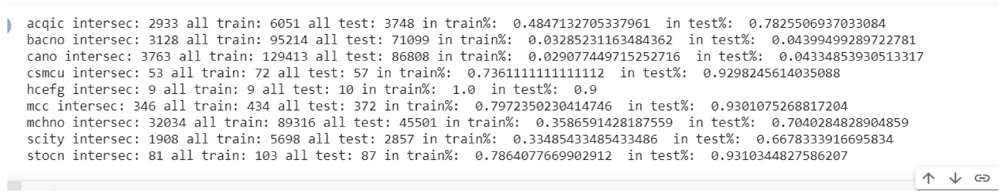

In [4]:
import matplotlib.pyplot as plt # plt 用于显示图片
import matplotlib.image as mpimg # mpimg 用于读取图片
import numpy as np

image = mpimg.imread('image.png') # 读取和代码处于同一目录下的 lena.png
# 此时 lena 就已经是一个 np.array 了，可以对它进行任意处理
image.shape #(512, 512, 3)
plt.figure(figsize=(8*10,4*10))
plt.imshow(image) # 显示图片
plt.axis('off') # 不显示坐标轴
plt.show()

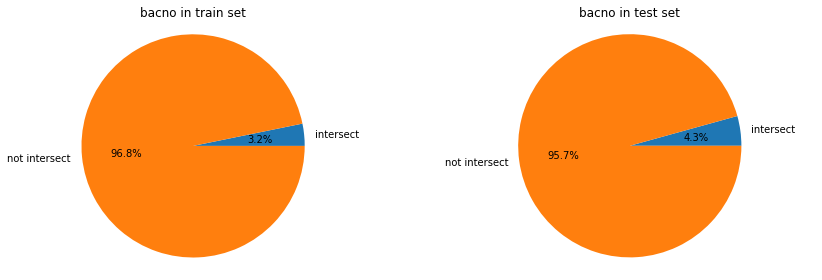

In [196]:
fig = plt.figure(figsize=(30,10))
labels = 'intersect','not intersect'
size = [32,968]
#this line will produce a figure which has 2 row 
#and 4 columns 
#(0, 0) specifies the left upper coordinate of your plot
ax1 = plt.subplot2grid((2,4),(0,0))
plt.pie(size , labels = labels,autopct='%1.1f%%')
plt.axis('equal')
plt.title('bacno in train set');
#next one
size = [43,957]
ax1 = plt.subplot2grid((2, 4), (0, 1))
plt.pie(size , labels = labels,autopct='%1.1f%%')
plt.axis('equal')
plt.title('bacno in test set');

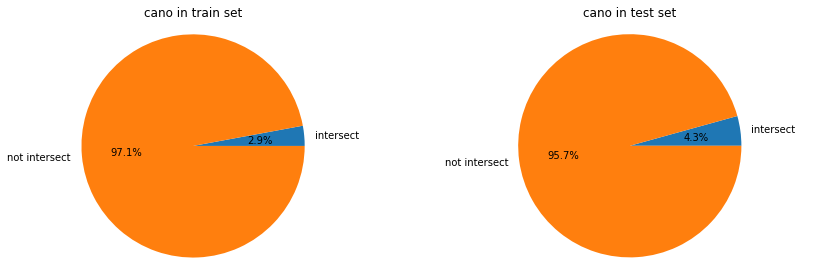

In [195]:
fig = plt.figure(figsize=(30,10))
labels = 'intersect','not intersect'
size = [29,971]
#this line will produce a figure which has 2 row 
#and 4 columns 
#(0, 0) specifies the left upper coordinate of your plot
ax1 = plt.subplot2grid((2,4),(0,0))
plt.pie(size , labels = labels,autopct='%1.1f%%')
plt.axis('equal')
plt.title('cano in train set');
#next one
size = [43,957]
ax1 = plt.subplot2grid((2, 4), (0, 1))
plt.pie(size , labels = labels,autopct='%1.1f%%')
plt.axis('equal')
plt.title('cano in test set');